In [1]:
import pandas as pd
import numpy as np 
import itertools
import keras
from keras.applications.xception import Xception
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img 
from keras.models import Sequential 
from keras import optimizers
from keras.preprocessing import image
from keras.layers import Dropout, Flatten, Dense, LeakyReLU 
from keras import applications  
from keras.utils.np_utils import to_categorical
from keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard, ReduceLROnPlateau
from keras import backend as K

import matplotlib.pyplot as plt 
import matplotlib.image as mpimg
%matplotlib inline
import math  
import datetime
import time

Using TensorFlow backend.


In [2]:
#Default dimensions
img_width, img_height = 299, 299  
   
#Create a bottleneck file
top_model_weights_path = 'bottleneck_fc_model-xception.h5' 

# loading up our datasets
train_data_dir = 'storage/train'  
validation_data_dir = 'storage/valid'
test_data_dir = 'storage/test'
   
# number of epochs to train top model  
epochs = 15 #this has been changed after multiple model run  
# batch size used by flow_from_directory and predict_generator  
batch_size = 50

In [3]:
xception = Xception(include_top=False, weights='imagenet')

In [4]:
datagen = ImageDataGenerator(rescale=1. / 255,
    featurewise_center=True,
    featurewise_std_normalization=True,
    rotation_range=10,
    shear_range=.12,
    width_shift_range=0.08,
    height_shift_range=0.15,
    horizontal_flip=True)

In [10]:
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

start = datetime.datetime.now()

generator = datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode=None,
    shuffle=False)

nb_train_samples = len(generator.filenames)
num_classes = len(generator.class_indices)

predict_size_train = int(math.ceil(nb_train_samples / batch_size))

bottleneck_features_train = xception.predict_generator(generator, predict_size_train)

np.save('bottleneck_features_train-xception.npy', bottleneck_features_train)

end= datetime.datetime.now() 
elapsed= end-start 
print ('Time: ', elapsed)

Found 3867 images belonging to 6 classes.
Time:  0:11:39.166741


In [11]:
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

start = datetime.datetime.now() 

datagen = ImageDataGenerator(rescale=1. / 255)

generator = datagen.flow_from_directory(
    validation_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode=None,
    shuffle=False)

nb_validation_samples = len(generator.filenames)

predict_size_validation = int(math.ceil(nb_validation_samples / batch_size))

bottleneck_features_validation = xception.predict_generator(
generator, predict_size_validation)

np.save('bottleneck_features_validation-xception.npy', bottleneck_features_validation)

end= datetime.datetime.now() 
elapsed= end-start 
print ('Time: ', elapsed)

Found 1030 images belonging to 6 classes.
Time:  0:03:10.834713


In [12]:
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

start = datetime.datetime.now()

datagen = ImageDataGenerator(rescale=1. / 255)

generator = datagen.flow_from_directory(
    test_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode=None,
    shuffle=False)

nb_test_samples = len(generator.filenames)

predict_size_test = int(math.ceil(nb_test_samples / batch_size))

bottleneck_features_test = xception.predict_generator(
generator, predict_size_test)

np.save('bottleneck_features_test-xception.npy', bottleneck_features_test) 

end= datetime.datetime.now() 
elapsed= end-start 
print ('Time: ', elapsed)

Found 1018 images belonging to 6 classes.


/home/evan13/miniconda3/envs/tensorflow/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:763: UserWarning: Possibly corrupt EXIF data.  Expecting to read 33554432 bytes but only got 0. Skipping tag 516
  " Skipping tag %s" % (size, len(data), tag))
/home/evan13/miniconda3/envs/tensorflow/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:763: UserWarning: Possibly corrupt EXIF data.  Expecting to read 69337600 bytes but only got 0. Skipping tag 3072
  " Skipping tag %s" % (size, len(data), tag))
/home/evan13/miniconda3/envs/tensorflow/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:763: UserWarning: Possibly corrupt EXIF data.  Expecting to read 19988480 bytes but only got 0. Skipping tag 0
  " Skipping tag %s" % (size, len(data), tag))
/home/evan13/miniconda3/envs/tensorflow/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:763: UserWarning: Possibly corrupt EXIF data.  Expecting to read 2046820352 bytes but only got 0. Skipping tag 0
  " Skipping tag %s" % (size, len(data), tag

Time:  0:03:03.259790


In [5]:
datagen_top = ImageDataGenerator(rescale=1./255)

In [6]:
#training data
generator_top = datagen_top.flow_from_directory(  
         train_data_dir,  
         target_size=(img_width, img_height),  
         batch_size=batch_size,  
         class_mode='categorical',  
         shuffle=False)  
   
nb_train_samples = len(generator_top.filenames)  
num_classes = len(generator_top.class_indices)  
   
# load the bottleneck features saved earlier  
train_data = np.load('bottleneck_features_train-xception.npy')  
   
# get the class lebels for the training data, in the original order  
train_labels = generator_top.classes  
   
# convert the training labels to categorical vectors  
train_labels = to_categorical(train_labels, num_classes=num_classes)

Found 3867 images belonging to 6 classes.


In [7]:
#validation data
generator_top = datagen_top.flow_from_directory(  
         validation_data_dir,  
         target_size=(img_width, img_height),  
         batch_size=batch_size,  
         class_mode=None,  
         shuffle=False)  
   
nb_validation_samples = len(generator_top.filenames)  
   
validation_data = np.load('bottleneck_features_validation-xception.npy')  
   

validation_labels = generator_top.classes  
validation_labels = to_categorical(validation_labels, num_classes=num_classes)

Found 1030 images belonging to 6 classes.


In [8]:
#testing data
generator_top = datagen_top.flow_from_directory(  
         test_data_dir,  
         target_size=(img_width, img_height),  
         batch_size=batch_size,  
         class_mode=None,  
         shuffle=False)  
   
nb_test_samples = len(generator_top.filenames)  
   
test_data = np.load('bottleneck_features_test-xception.npy')  
   

test_labels = generator_top.classes  
test_labels = to_categorical(test_labels, num_classes=num_classes)

Found 1018 images belonging to 6 classes.


In [17]:
K.set_session(K.tf.Session(config=K.tf.ConfigProto(intra_op_parallelism_threads=60, 
                                                   inter_op_parallelism_threads=60)))

In [12]:
NAME = 'Xception CNN-{}'.format(int(time.time()))

#This is the best model we found. For additional models, check out I_notebook.ipynb
start = datetime.datetime.now()
model = Sequential()

model.add(Flatten(input_shape=train_data.shape[1:]))

model.add(Dense(256, activation='linear'))
model.add(LeakyReLU(alpha=0.3))
model.add(Dropout(0.5))
model.add(Dense(128, activation='linear'))
model.add(LeakyReLU(alpha=0.3))
model.add(Dropout(0.5))  
model.add(Dense(64, activation='linear'))
model.add(LeakyReLU(alpha=0.3))
model.add(Dropout(0.3)) 
model.add(Dense(num_classes, activation='softmax'))

model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

tensorboard = TensorBoard(log_dir='logs/{}'.format(NAME))
reduce_lr = ReduceLROnPlateau(monitor='val_acc', factor=0.1, patience=5)
checkpoint = ModelCheckpoint(filepath='xception.h5', monitor='val_acc', save_best_only=True)
early_stop = EarlyStopping(monitor='acc', patience=2)

history = model.fit(train_data, train_labels,
                    epochs=70,
                    batch_size=batch_size,
                    validation_data=(validation_data, validation_labels),
                    validation_split=0.2,
                    callbacks=[tensorboard, reduce_lr, checkpoint, early_stop])  

model.save_weights(top_model_weights_path)  

(eval_loss, eval_accuracy) = model.evaluate(  
 validation_data, validation_labels, batch_size=batch_size, verbose=1)

print("[INFO] accuracy: {:.2f}%".format(eval_accuracy * 100))  
print("[INFO] Loss: {}".format(eval_loss))  
end= datetime.datetime.now()
elapsed= end-start
print ('Time: ', elapsed)

Train on 3867 samples, validate on 1030 samples
Epoch 1/70
3867/3867 [==============================] - 34s 9ms/step - loss: 2.2977 - acc: 0.4469 - val_loss: 0.8302 - val_acc: 0.7301
Epoch 2/70
3867/3867 [==============================] - 30s 8ms/step - loss: 1.7060 - acc: 0.5997 - val_loss: 0.9772 - val_acc: 0.7447
Epoch 3/70
3867/3867 [==============================] - 28s 7ms/step - loss: 1.4056 - acc: 0.6618 - val_loss: 0.9433 - val_acc: 0.7786
Epoch 4/70
3867/3867 [==============================] - 28s 7ms/step - loss: 1.2709 - acc: 0.7067 - val_loss: 0.8210 - val_acc: 0.8146
Epoch 5/70
3867/3867 [==============================] - 28s 7ms/step - loss: 1.2454 - acc: 0.7393 - val_loss: 0.9763 - val_acc: 0.7942
Epoch 6/70
3867/3867 [==============================] - 28s 7ms/step - loss: 1.0609 - acc: 0.7647 - val_loss: 0.6653 - val_acc: 0.8408
Epoch 7/70
3867/3867 [==============================] - 28s 7ms/step - loss: 1.0150 - acc: 0.7784 - val_loss: 0.6601 - val_acc: 0.8350
Epoch 8

In [13]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_1 (Flatten)          (None, 204800)            0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               52429056  
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 128)               32896     
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 128)               0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 128)               0         
__________

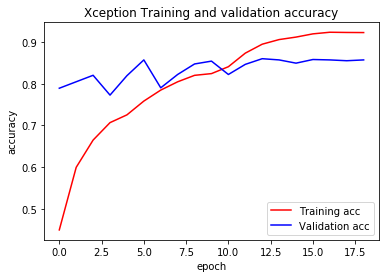

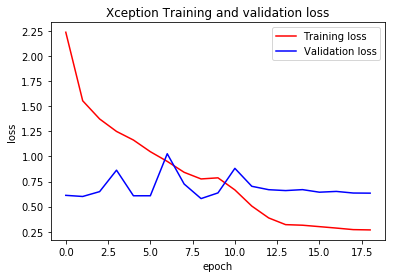

In [20]:

#Graphing our training and validation
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(len(acc))
plt.plot(epochs, acc, 'r', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Xception Training and validation accuracy')
plt.ylabel('accuracy')  
plt.xlabel('epoch')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Xception Training and validation loss')
plt.ylabel('loss')  
plt.xlabel('epoch')
plt.legend()
plt.show()

In [14]:
def read_image(file_path):
    image = load_img(file_path, target_size=(299, 299))  
    image = img_to_array(image)  
    image = np.expand_dims(image, axis=0)
    image /= 255.
    return image

In [15]:
def test_single_image(path):
    houses = ['Dutch Colonial', 'Greek Revival', 'Spanish Revival', 'Tudor', 'Victorian - Queen Anne', 'Victorian - Second Empire']
    images = read_image(path)
    time.sleep(.5)
    bt_prediction = xception.predict(images)  
    preds = model.predict_proba(bt_prediction)
    for idx, house, x in zip(range(0,6), houses , preds[0]):
        print("Likelihood: {} {}%".format(house, round(x*100,2) ))
    #print('Final Decision:')
    print('')
    time.sleep(.5)
    #for x in range(3):
    #    print('.'*(x+1))
    #    time.sleep(.2)
    class_predicted = model.predict_classes(bt_prediction)
    class_dictionary = generator_top.class_indices  
    inv_map = {v: k.title() for k, v in class_dictionary.items()}
    print("Predicted Architecture Style - {}".format(inv_map[class_predicted[0]]))  
    return load_img(path)

In [83]:
path = 'casa-hillary.jpg'

Likelihood: Dutch Colonial 100.0%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 0.0%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 0.0%

Predicted Architecture Style - Dutch


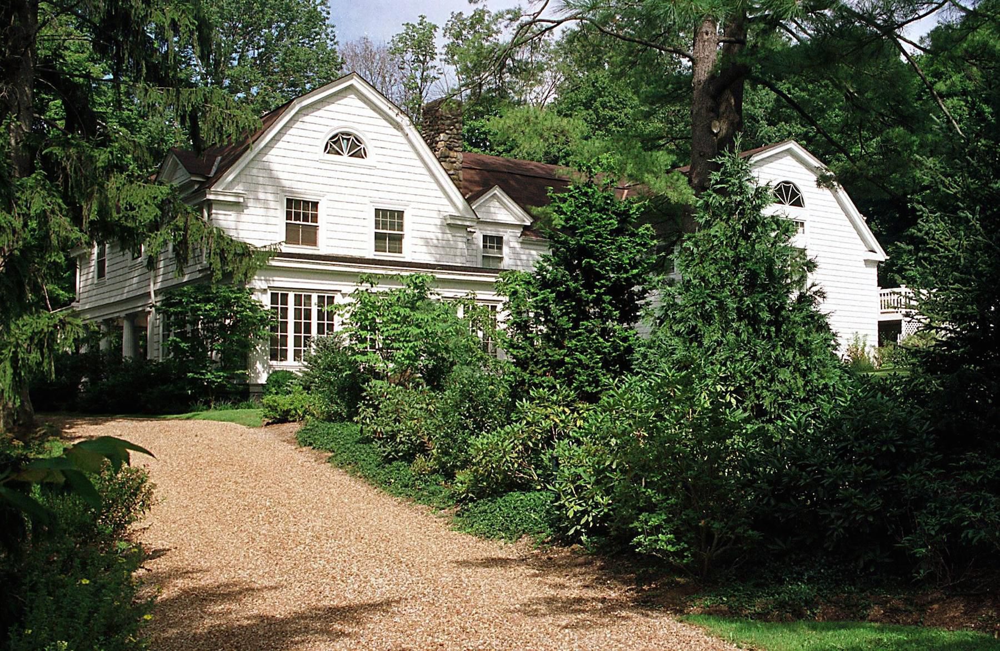

In [84]:
test_single_image(path)

In [85]:
path2 = 'casa-walsh.jpg'

Likelihood: Dutch Colonial 0.0%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 100.0%
Likelihood: Tudor 0.0%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 0.0%

Predicted Architecture Style - Spanish


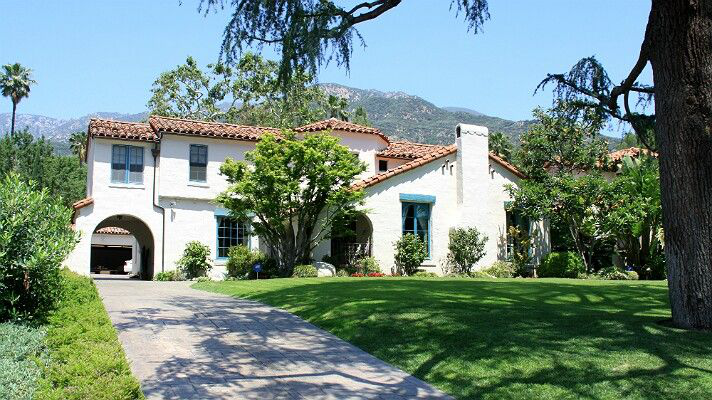

In [86]:
test_single_image(path2)

Likelihood: Dutch Colonial 0.0%
Likelihood: Greek Revival 100.0%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 0.0%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 0.0%

Predicted Architecture Style - Greek


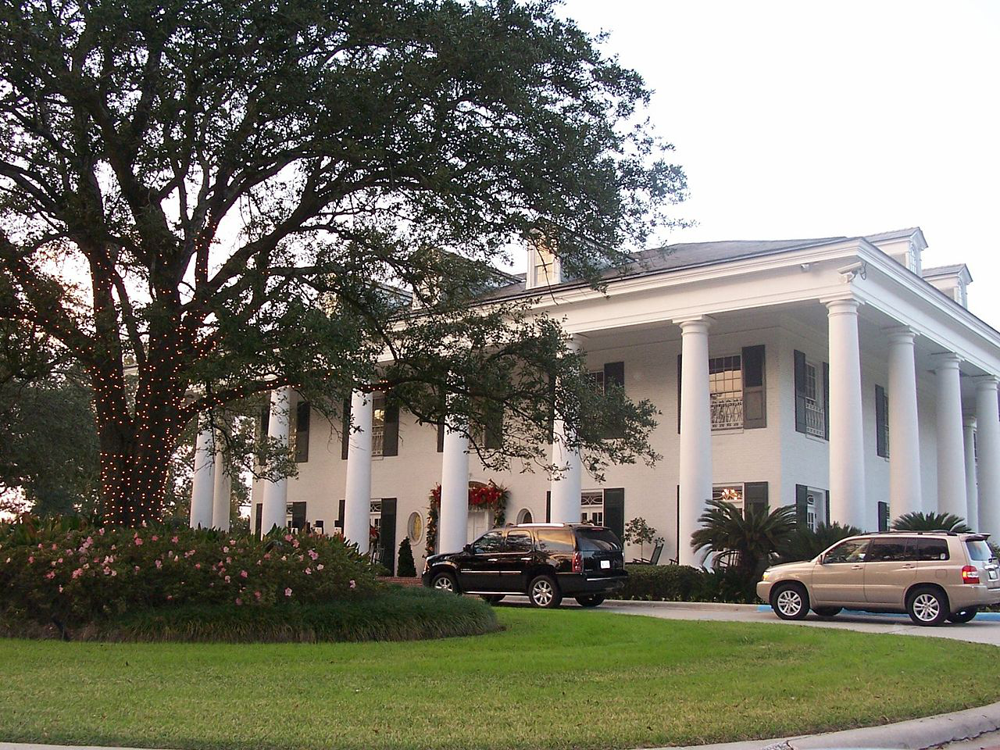

In [87]:
path3 = 'casa-la.jpg'
test_single_image(path3)

Likelihood: Dutch Colonial 0.0%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 9.6%
Likelihood: Victorian - Queen Anne 90.39%
Likelihood: Victorian - Second Empire 0.01%

Predicted Architecture Style - Vict_Queen


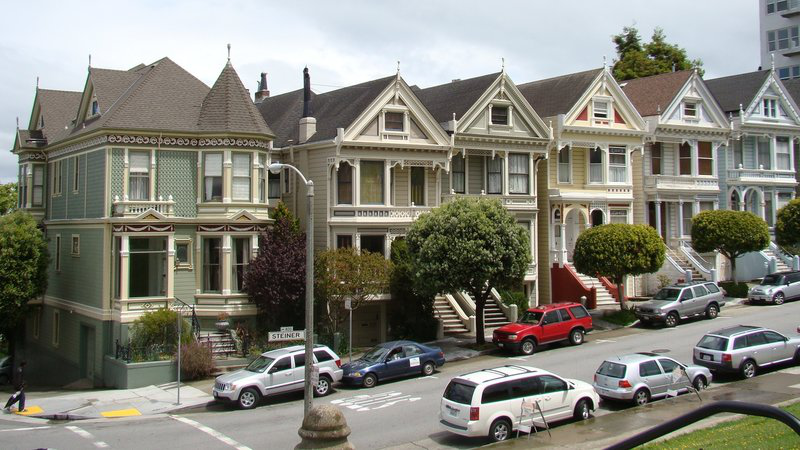

In [88]:
path4 = 'casa-painted.jpg'
test_single_image(path4)

Likelihood: Dutch Colonial 0.0%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 1.5%
Likelihood: Victorian - Queen Anne 98.41%
Likelihood: Victorian - Second Empire 0.09%

Predicted Architecture Style - Vict_Queen


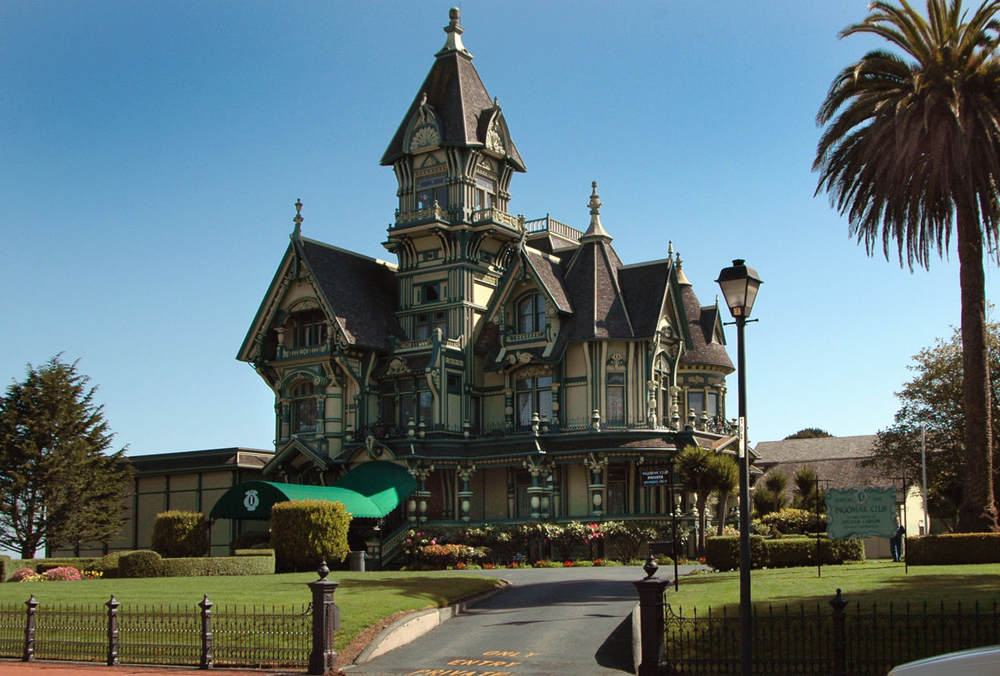

In [89]:
path5 = 'casa-carson.jpg'
test_single_image(path5)

Likelihood: Dutch Colonial 0.0%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 54.07%
Likelihood: Victorian - Queen Anne 45.78%
Likelihood: Victorian - Second Empire 0.15%

Predicted Architecture Style - Tudor


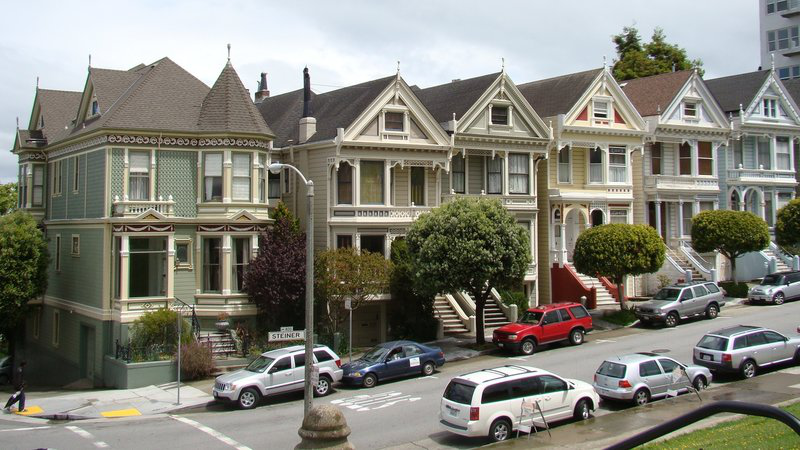

In [16]:
path5 = 'casa-painted.jpg'
test_single_image(path5)

Likelihood: Dutch Colonial 82.19%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 4.04%
Likelihood: Tudor 13.74%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 0.02%

Predicted Architecture Style - Dutch


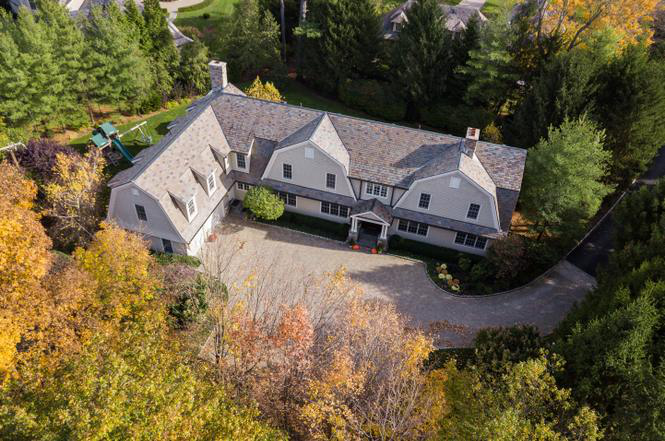

In [17]:
path7 = 'image-7.jpg'
test_single_image(path7)

Likelihood: Dutch Colonial 0.01%
Likelihood: Greek Revival 0.05%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 0.13%
Likelihood: Victorian - Queen Anne 0.07%
Likelihood: Victorian - Second Empire 99.74%

Predicted Architecture Style - Vict_Second


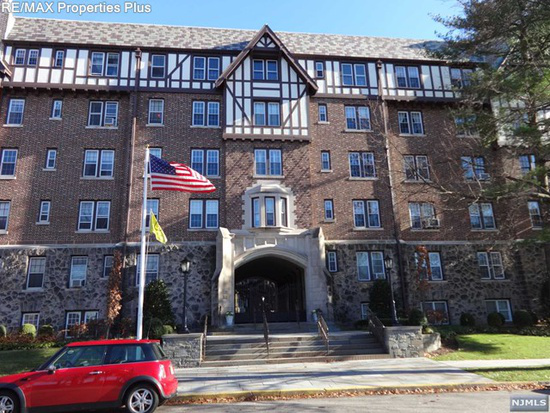

In [18]:
path8 = 'image-8.jpg'
test_single_image(path8)

Likelihood: Dutch Colonial 99.99%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 0.01%
Likelihood: Tudor 0.0%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 0.0%

Predicted Architecture Style - Dutch


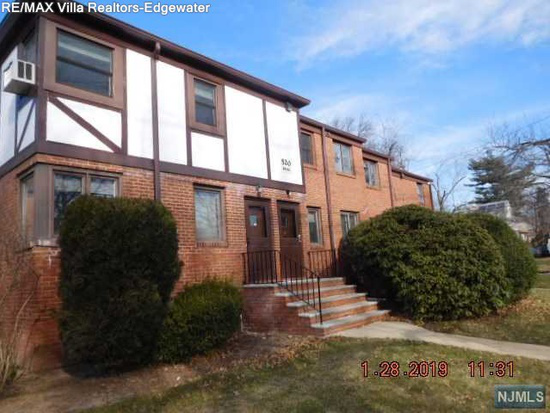

In [19]:
path9 = 'image-9.jpg'
test_single_image(path9)

Likelihood: Dutch Colonial 0.0%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 100.0%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 0.0%

Predicted Architecture Style - Tudor


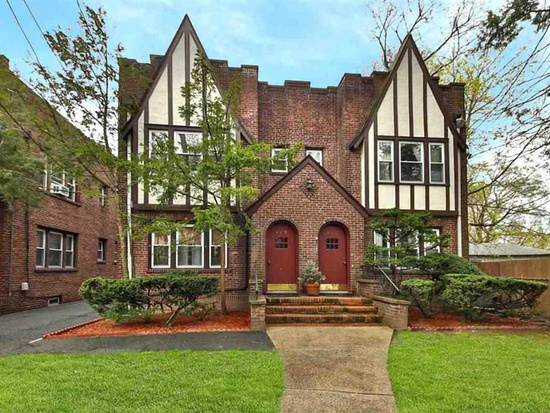

In [20]:
path10 = 'image-10.jpg'
test_single_image(path10)

Likelihood: Dutch Colonial 0.02%
Likelihood: Greek Revival 0.04%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 37.86%
Likelihood: Victorian - Queen Anne 62.07%
Likelihood: Victorian - Second Empire 0.01%

Predicted Architecture Style - Vict_Queen


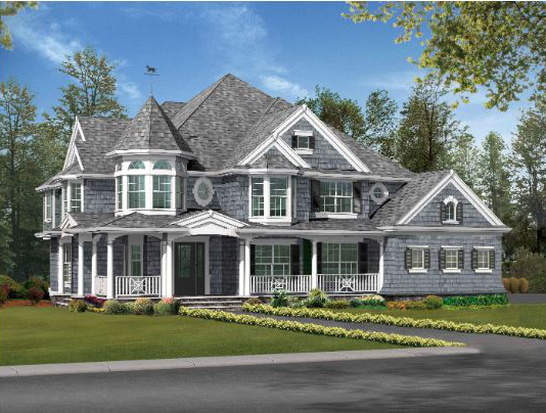

In [95]:
path11 = 'image-11.jpg'
test_single_image(path11)

Likelihood: Dutch Colonial 0.0%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 0.0%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 100.0%

Predicted Architecture Style - Vict_Second


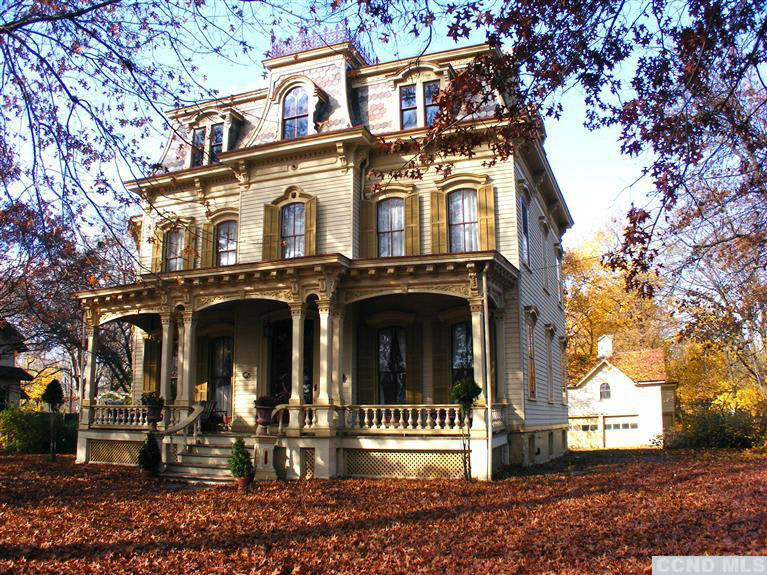

In [96]:
path12 = 'image-12.jpg'
test_single_image(path12)

Likelihood: Dutch Colonial 0.0%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 0.0%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 100.0%

Predicted Architecture Style - Vict_Second


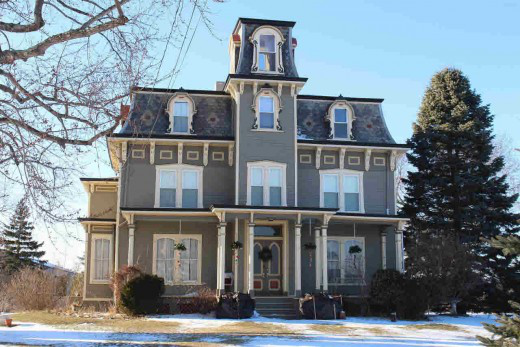

In [97]:
path13 = 'image-13.jpg'
test_single_image(path13)

Likelihood: Dutch Colonial 0.0%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 100.0%
Likelihood: Tudor 0.0%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 0.0%

Predicted Architecture Style - Spanish


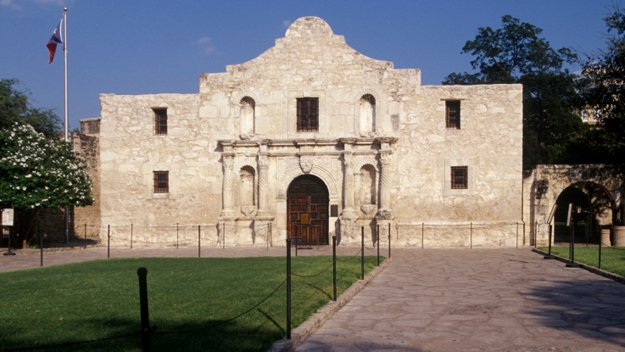

In [98]:
alamo = 'alamo.jpg'
test_single_image(alamo)

Likelihood: Dutch Colonial 0.06%
Likelihood: Greek Revival 3.36%
Likelihood: Spanish Revival 0.06%
Likelihood: Tudor 96.5%
Likelihood: Victorian - Queen Anne 0.02%
Likelihood: Victorian - Second Empire 0.0%

Predicted Architecture Style - Tudor


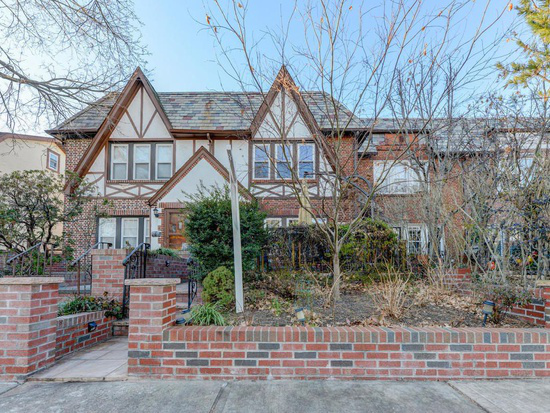

In [99]:
forest = 'forest.jpg'
test_single_image(forest)

In [24]:
pictures = ['images793.jpg','images798.jpg','images799.jpg','images814.jpg','images816.jpg','images819.jpg','images826.jpg','images843.jpg']

In [25]:
for pic in pictures:
    test_single_image(pic)

Likelihood: Dutch Colonial 30.04%
Likelihood: Greek Revival 13.22%
Likelihood: Spanish Revival 0.89%
Likelihood: Tudor 1.21%
Likelihood: Victorian - Queen Anne 52.49%
Likelihood: Victorian - Second Empire 2.15%

Predicted Architecture Style - Vict_Queen
Likelihood: Dutch Colonial 88.11%
Likelihood: Greek Revival 0.17%
Likelihood: Spanish Revival 3.04%
Likelihood: Tudor 8.65%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 0.03%

Predicted Architecture Style - Dutch
Likelihood: Dutch Colonial 2.41%
Likelihood: Greek Revival 93.31%
Likelihood: Spanish Revival 0.03%
Likelihood: Tudor 3.84%
Likelihood: Victorian - Queen Anne 0.01%
Likelihood: Victorian - Second Empire 0.41%

Predicted Architecture Style - Greek
Likelihood: Dutch Colonial 100.0%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 0.0%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 0.0%

Predicted Architecture Style - Dutch
Likelihood:

In [26]:
x1 = 'images793.jpg'
x2 = 'images799.jpg'
x3 = 'images819.jpg'

Likelihood: Dutch Colonial 30.04%
Likelihood: Greek Revival 13.22%
Likelihood: Spanish Revival 0.89%
Likelihood: Tudor 1.21%
Likelihood: Victorian - Queen Anne 52.49%
Likelihood: Victorian - Second Empire 2.15%

Predicted Architecture Style - Vict_Queen


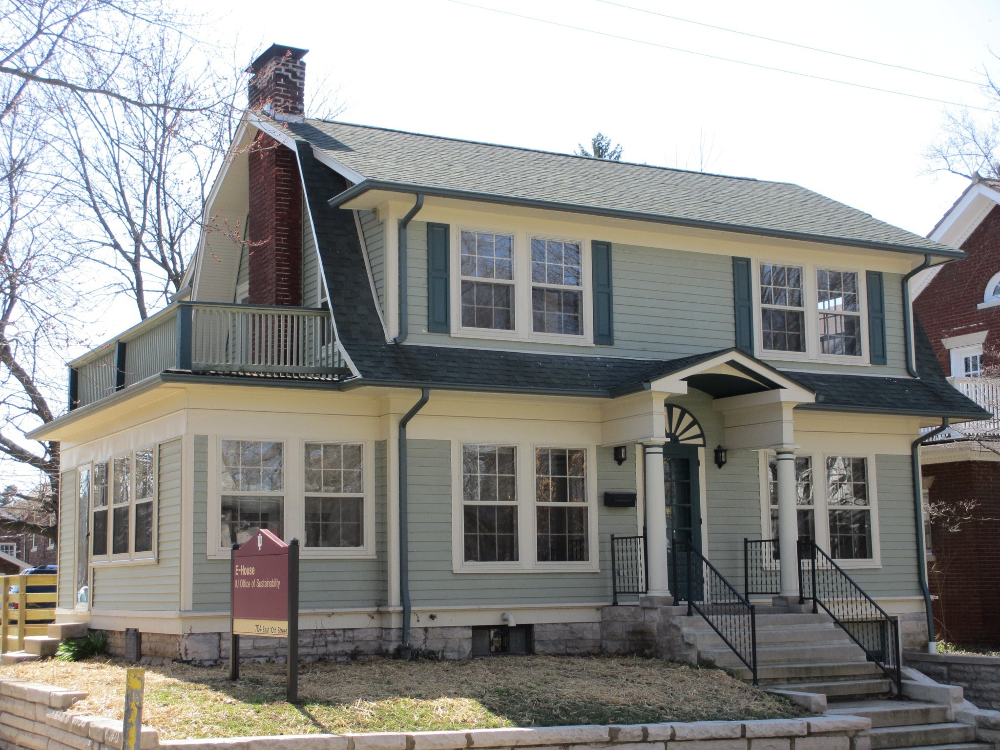

In [27]:
test_single_image(x1)

Likelihood: Dutch Colonial 2.41%
Likelihood: Greek Revival 93.31%
Likelihood: Spanish Revival 0.03%
Likelihood: Tudor 3.84%
Likelihood: Victorian - Queen Anne 0.01%
Likelihood: Victorian - Second Empire 0.41%

Predicted Architecture Style - Greek


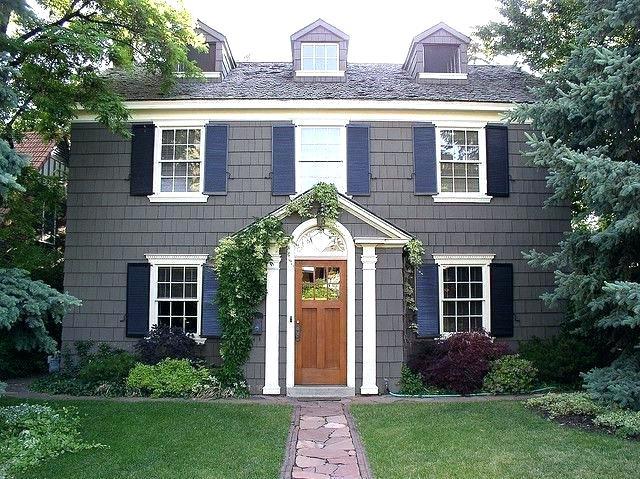

In [28]:
test_single_image(x2)

Likelihood: Dutch Colonial 57.63%
Likelihood: Greek Revival 0.22%
Likelihood: Spanish Revival 0.17%
Likelihood: Tudor 6.09%
Likelihood: Victorian - Queen Anne 35.02%
Likelihood: Victorian - Second Empire 0.88%

Predicted Architecture Style - Dutch


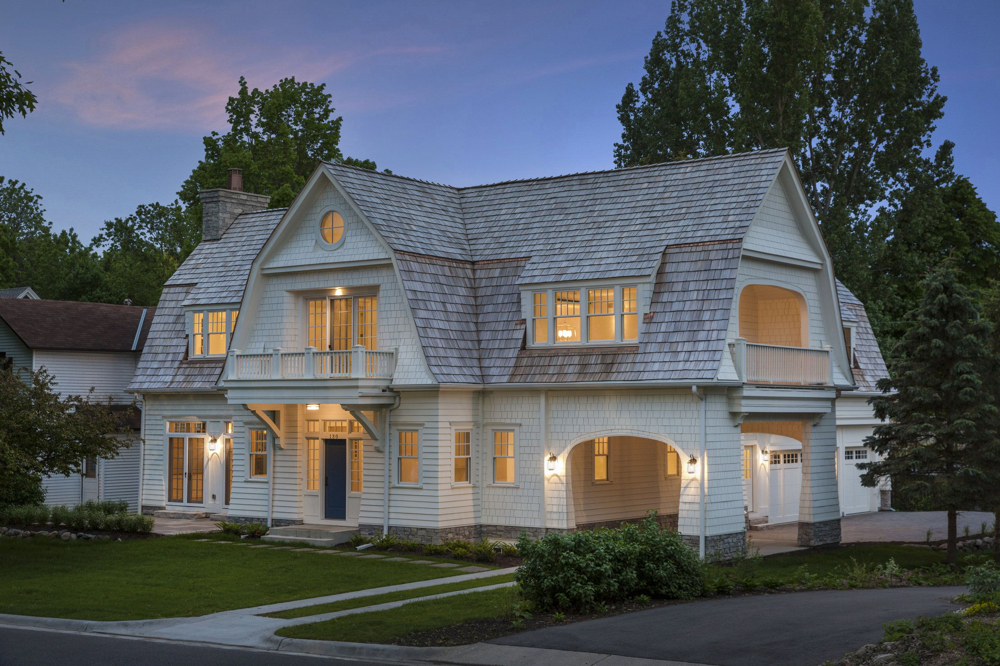

In [29]:
test_single_image(x3)

Likelihood: Dutch Colonial 99.99%
Likelihood: Greek Revival 0.0%
Likelihood: Spanish Revival 0.0%
Likelihood: Tudor 0.01%
Likelihood: Victorian - Queen Anne 0.0%
Likelihood: Victorian - Second Empire 0.0%

Predicted Architecture Style - Dutch


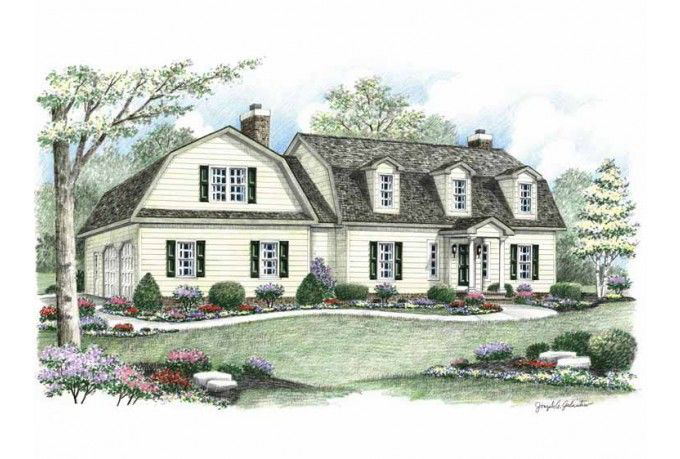

In [30]:
x4 = 'images816.jpg'
test_single_image(x4)